## FFCV Dataset cache playground

Description: 

Created On: Thursday Feb 10th, 2022  
Created By: Jacob A Rose

In [8]:
import pickle
import copy
import os

label_path = "/media/data_cifs/projects/prj_fossils/users/jacob/data/leavesdb-v1_1/Extant_Leaves_family_100_1024/splits/splits=(0.5,0.2,0.3)/family-encoder.pkl"

catalog_names = sorted(os.listdir("/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/catalogs/"))


with open(label_path, "rb") as f:
    labels = pickle.load(f)
    
labels

### Key constants

In [1]:
DATASETS_ROOT = "/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images"
EXTANT_ROOT = "/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Extant_Leaves/original/full/jpg"
GENERAL_ROOT = "/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/General_Fossil/original/full/jpg"
FLORISSANT_ROOT = "/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/Florissant_Fossil/original/full/jpg"

OUTPUTS_DIR = "/media/data/jacob/GitHub/image-utils/notebooks/plots"

DATA_CACHE_DIR = "/media/data/jacob/GitHub/image-utils/notebooks/data"

In [2]:
CATALOG_SPLITS_ROOT = "/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/catalogs"

### Code Definitions

In [3]:
%load_ext autoreload
%autoreload 2

from pprint import pprint as pp
# import torchdatasets
# import solo
# all_densenet_models = timm.list_models('*densenet*')
# all_resnet_models = timm.list_models('*resnet*')
# pp(all_resnet_models)
# pp(all_densenet_models)

import os
import itertools
import ipyplot
from collections import Counter
# plt.rcParams['figure.dpi'] = 300
# plt.rcParams['savefig.dpi'] = 300

import imutils

from image_catalog import catalog_registry

Importing imutils


In [23]:
from typing import *
from image_catalog.utils.etl_utils import ETL
from image_catalog.catalog_registry import *




@dataclass
class BaseSplitsRegistry(BaseCatalog):



    @classmethod
    def get_full_catalog_csv(cls, catalog_dir: str):
        path = [os.path.join(catalog_dir, file_name) for file_name in o.listdir(catalog_dir) if file_name.endswith("full_dataset.csv")][0]
        return ETL.df_from_csv(path)

    @classmethod
    def get_split_catalog_csv(cls, catalog_dir: str,
                              splits: Optional[Tuple[float]]=None):
        if splits is None:
            splits_dir = [os.path.join(catalog_dir, "splits", split_name) for split_name in os.listdir(os.path.join(catalog_dir, "splits"))][0]
        else:
            assert isinstance(splits, Tuple)
            assert len(splits) == 3
            assert all([isinstance(s, float) for s in splits])
            splits_dir = os.path.join(catalog_dir, "splits", f"{splits=}")

        splits_csv_paths = {subset: os.path.join(splits_dir, f"{subset}_metadata.csv") for subset in ["train", "val", "test"]}
        splits_dfs = {subset: ETL.df_from_csv(path, index_col=0) for subset, path in splits_csv_paths.items()}

        return splits_dfs, splits_csv_paths



In [24]:
tag = catalog_registry.available_datasets.query_tags("PNAS", threshold=100, resolution=512)



all_catalogs = {tag: os.path.join(CATALOG_SPLITS_ROOT, tag) for tag in sorted(os.listdir(CATALOG_SPLITS_ROOT))}
split_catalogs = {tag: path for tag, path in all_catalogs.items() if "splits" in os.listdir(path)}

catalog_dir = split_catalogs[tag]



full_df = get_full_catalog_csv(catalog_dir=catalog_dir)
splits_dfs, splits_csv_paths = get_split_catalog_csv(catalog_dir=catalog_dir)
                                           

2022-11-01 07:12:13,734 image_catalog.catalog_registry INFO     Found latest version of tag='PNAS_family_100_512' in version='v1_1'


In [27]:
splits_dfs["train"]

splits_dfs["val"]

splits_dfs["test"]

In [4]:
catalog_registry.available_datasets.search("PNAS")

{'PNAS_family_100_original': '/media/data_cifs/projects/prj_fossils/data/processed_data/data_splits/PNAS_family_100',
 'PNAS_original': '/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v0_1/PNAS',
 'PNAS_family_100_512': '/media/data_cifs/projects/prj_fossils/data/processed_data/data_splits/PNAS_family_100_512',
 'PNAS_family_100_1024': '/media/data_cifs/projects/prj_fossils/data/processed_data/data_splits/PNAS_family_100_1024',
 'PNAS_family_100_1536': '/media/data_cifs/projects/prj_fossils/data/processed_data/data_splits/PNAS_family_100_1536',
 'PNAS_family_100_2048': '/media/data_cifs/projects/prj_fossils/data/processed_data/data_splits/PNAS_family_100_2048'}

In [5]:
catalog_registry.available_datasets.query_tags("PNAS", threshold=4)

2022-11-01 02:39:08,953 image_catalog.catalog_registry INFO     Found latest version of tag='PNAS_family_4_original' in version='v0_3'


'PNAS_family_4_original'

In [11]:
!ls -al {catalog_registry.available_datasets.get("PNAS_family_100_512")}/train

total 0
drwxrwxrwx 2 cis-storage cis-storage   9728 Apr  9  2021 .
drwxrwxrwx 2 cis-storage cis-storage   1024 Apr  9  2021 ..
drwxrwxrwx 2 cis-storage cis-storage  31744 Apr  9  2021 Anacardiaceae
drwxrwxrwx 2 cis-storage cis-storage  89600 Apr  9  2021 Annonaceae
drwxrwxrwx 2 cis-storage cis-storage  62464 Apr  9  2021 Apocynaceae
drwxrwxrwx 2 cis-storage cis-storage  35328 Apr  9  2021 Betulaceae
drwxrwxrwx 2 cis-storage cis-storage  33280 Apr  9  2021 Celastraceae
drwxrwxrwx 2 cis-storage cis-storage  49152 Apr  9  2021 Combretaceae
drwxrwxrwx 2 cis-storage cis-storage  47104 Apr  9  2021 Ericaceae
drwxrwxrwx 2 cis-storage cis-storage 198656 Apr  9  2021 Fabaceae
drwxrwxrwx 2 cis-storage cis-storage  47104 Apr  9  2021 Fagaceae
drwxrwxrwx 2 cis-storage cis-storage  78848 Apr  9  2021 Lauraceae
drwxrwxrwx 2 cis-storage cis-storage  49152 Apr  9  2021 Malvaceae
drwxrwxrwx 2 cis-storage cis-storage  49664 Apr  9  2021 Melastomataceae
drwxrwxrwx 2 cis-storage cis-storage 111104 Apr  9 

In [7]:
catalog_registry.available_datasets.get_latest("PNAS_original")

2022-10-31 04:20:11,484 image_catalog.catalog_registry INFO     Found latest version of tag='PNAS_original' in version='v1_1'


'/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v0_1/PNAS'

In [7]:
dir(catalog_registry.available_datasets.versions["v1_1"])

['Extant',
 'Extant_Leaves_1024',
 'Extant_Leaves_1536',
 'Extant_Leaves_2048',
 'Extant_Leaves_512',
 'Extant_Leaves_family_100_1024',
 'Extant_Leaves_family_100_1536',
 'Extant_Leaves_family_100_2048',
 'Extant_Leaves_family_100_512',
 'Extant_Leaves_family_10_1024',
 'Extant_Leaves_family_10_1536',
 'Extant_Leaves_family_10_2048',
 'Extant_Leaves_family_10_512',
 'Extant_Leaves_family_20_1024',
 'Extant_Leaves_family_20_1536',
 'Extant_Leaves_family_20_2048',
 'Extant_Leaves_family_20_512',
 'Extant_Leaves_family_3_1024',
 'Extant_Leaves_family_3_1536',
 'Extant_Leaves_family_3_2048',
 'Extant_Leaves_family_3_512',
 'Extant_Leaves_family_50_1024',
 'Extant_Leaves_family_50_1536',
 'Extant_Leaves_family_50_2048',
 'Extant_Leaves_original',
 'Florissant_Fossil_1024',
 'Florissant_Fossil_1536',
 'Florissant_Fossil_2048',
 'Florissant_Fossil_512',
 'Florissant_Fossil_family_10_1024',
 'Florissant_Fossil_family_10_1536',
 'Florissant_Fossil_family_10_2048',
 'Florissant_Fossil_family_10_

In [7]:
dir(catalog_registry.available_datasets)#.__file__

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__rich__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'add_dataset',
 'db_versions',
 'display_all',
 'extras',
 'get',
 'get_image_label_list',
 'get_latest',
 'query_tags',
 'search',
 'tags',
 'versions']

In [6]:
out = catalog_registry.available_datasets.add_dataset("Extant_processed", "/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Extant_Leaves/processed_edit18Jan22/outblur_Leavesdb-v1_1")
# dir(catalog_registry.available_datasets)
# catalog_registry.available_datasets.search("General_Fossil_family_10")
catalog_registry.available_datasets.search("Fossil_family_10")

Attempted to add existing dataset with tag: Extant_processed at root_dir: /media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Extant_Leaves/processed_edit18Jan22/outblur_Leavesdb-v1_1. Continuing with existing entry.


{'General_Fossil_family_10_512': '/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/General_Fossil/512/10/jpg',
 'General_Fossil_family_10_1024': '/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/General_Fossil/1024/10/jpg',
 'General_Fossil_family_10_1536': '/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/General_Fossil/1536/10/jpg',
 'General_Fossil_family_10_2048': '/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/General_Fossil/2048/10/jpg',
 'Florissant_Fossil_family_10_512': '/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/Florissant_Fossil/512/10/jpg',
 'Florissant_Fossil_family_10_1024': '/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/Florissant_Fossil/1024/10/jpg',
 'Florissant_Fossil_family_10_1536': '/media/data_cifs/projects/prj_fossils/data/processed_d

In [12]:
# catalog_registry.available_datasets.query_tags("Fossil", 10, "family", 512)
catalog_registry.available_datasets.query_tags("Fossil", resolution=512)

'Fossil_512'

In [13]:
import itertools

In [14]:
dir(os.path)

['__all__',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__spec__',
 '_get_sep',
 '_joinrealpath',
 '_varprog',
 '_varprogb',
 'abspath',
 'altsep',
 'basename',
 'commonpath',
 'commonprefix',
 'curdir',
 'defpath',
 'devnull',
 'dirname',
 'exists',
 'expanduser',
 'expandvars',
 'extsep',
 'genericpath',
 'getatime',
 'getctime',
 'getmtime',
 'getsize',
 'isabs',
 'isdir',
 'isfile',
 'islink',
 'ismount',
 'join',
 'lexists',
 'normcase',
 'normpath',
 'os',
 'pardir',
 'pathsep',
 'realpath',
 'relpath',
 'samefile',
 'sameopenfile',
 'samestat',
 'sep',
 'split',
 'splitdrive',
 'splitext',
 'stat',
 'supports_unicode_filenames',
 'sys']

In [16]:
from pathlib import Path

### TODO (Thur 2022-10-13) --

1. Left off having completed an MVP for a functional image dataset crawler based on an input of either a str or list of strs as root directories. (`root/class/image_files_i.jpg`)

In [33]:
# img_root_dir = catalog_registry.available_datasets.get("General_Fossil_family_10_512")
img_root_dir = catalog_registry.available_datasets.get("Fossil_family_10_512")


if isinstance(img_root_dir, (str, Path)):
    class_names = sorted(set(os.listdir(img_root_dir)))
    # class_dirs = [os.listdir(Path(img_root_dir, n)) for n in class_names]
    class_dirs = [os.path.join(img_root_dir, n) for n in class_names]
elif isinstance(img_root_dir, list):
    # Assume a list of image root dirs should be encoded using the union of their unique classes.
    class_names = sorted(set(itertools.chain(*[
        os.listdir(root_i) for root_i in img_root_dir
    ])))
    
    class_dirs = []
    for root_i in img_root_dir:
        class_dirs.extend([os.path.join(root_i, n) for n in os.listdir(root_i)])

class_dirs = sorted(class_dirs, key = lambda x: os.path.split(x)[1])
label_str2int = {n: i for i, n in enumerate(class_names)}

print(f"{img_root_dir=}" + "\n" + f"{len(class_names)=}" + "\n" + f"{len(class_dirs)=}")

path_list = [];
label_list = [];
name_list = [];
# label_str2int = {};

for i, d in enumerate(class_dirs):
    n = os.path.split(d)[1]
    
    # i_paths = sorted(os.listdir(class_dirs[i]))
    i_paths = [
        os.path.join(d, fname) 
        for fname in sorted(os.listdir(d))
    ]
    # i_labels = [i]*len(i_paths)
    path_list.extend(i_paths)
    label_list.extend([i]*len(i_paths))
    name_list.extend([n]*len(i_paths))
    # label_str2int[n] = i

    
# name_list = [class_names[l] for l in label_list]
def get_class_counts(name_list):
    class_counts = Counter(name_list)
    tab_labels = [f"{l}: {class_counts[l]}" for l in name_list]

    return class_counts, tab_labels

class_counts, tab_labels = get_class_counts(name_list)
ipyplot.plot_class_tabs(path_list, tab_labels)

img_root_dir=['/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/General_Fossil/512/10/jpg', '/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/Florissant_Fossil/512/10/jpg']
len(class_names)=28
len(class_dirs)=39



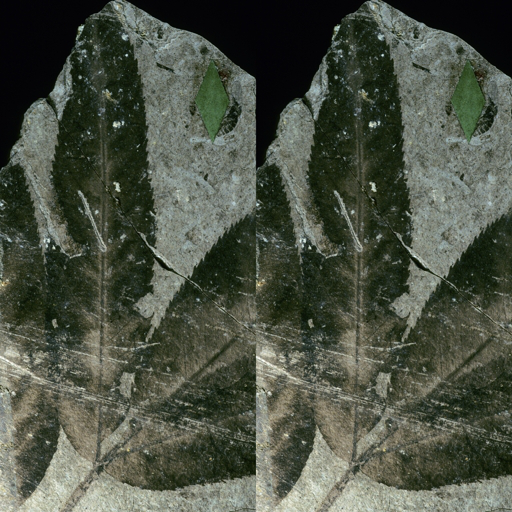
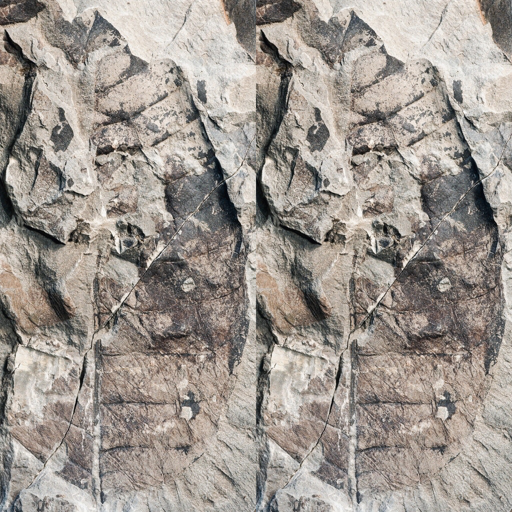
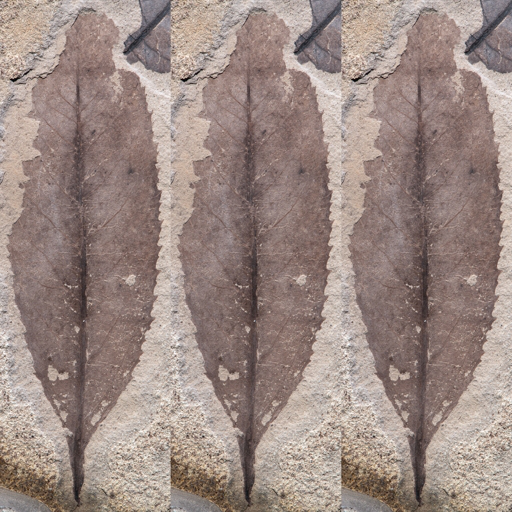
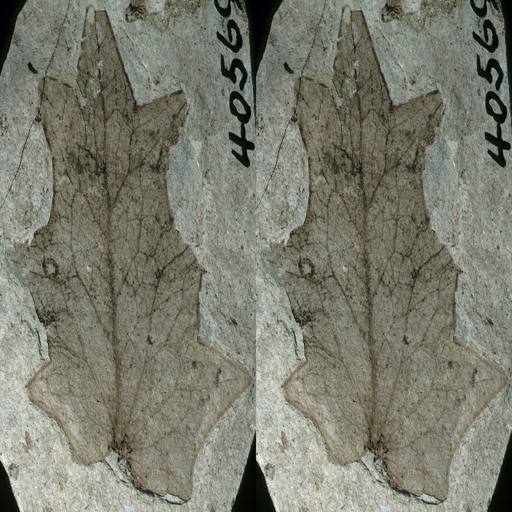
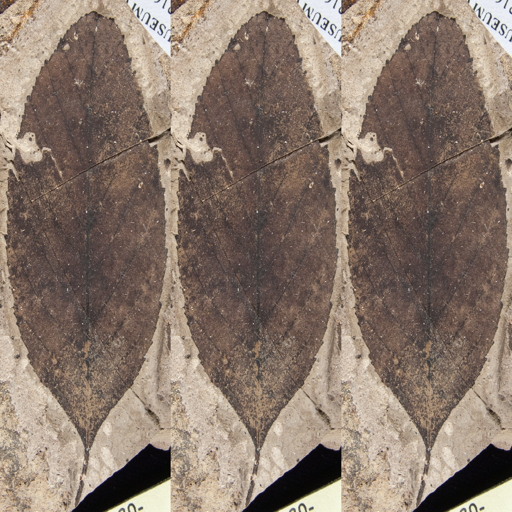
...
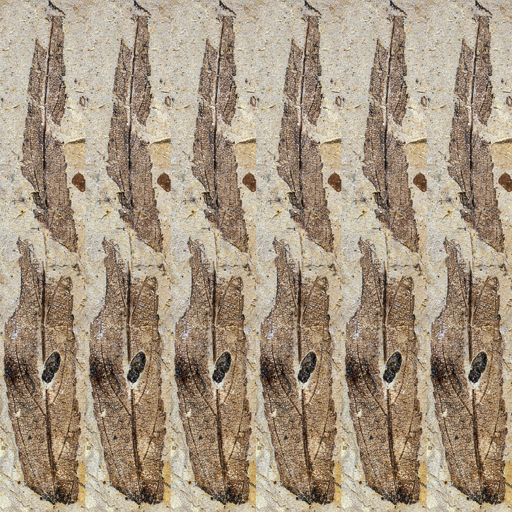
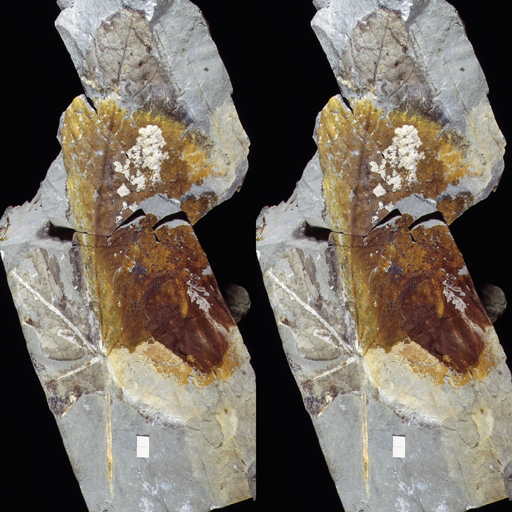
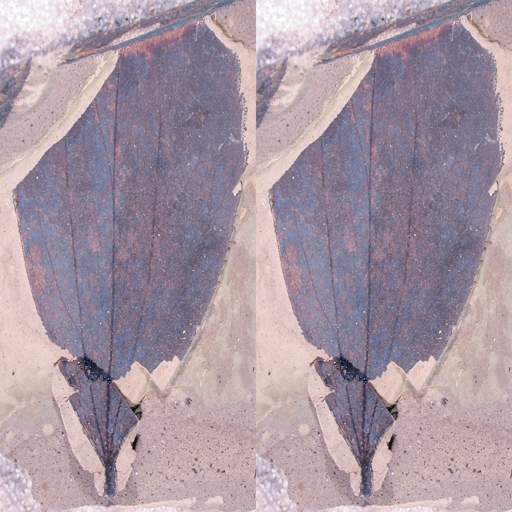
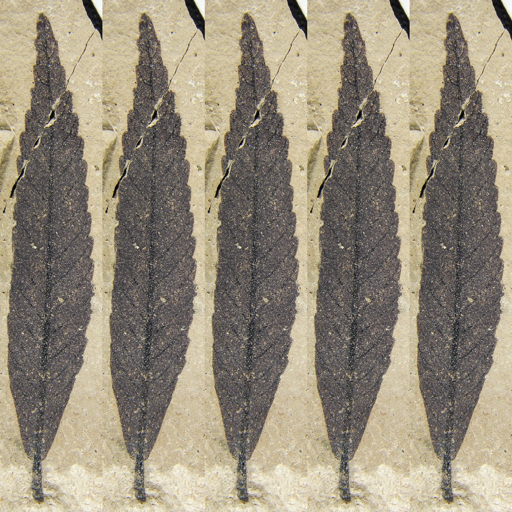
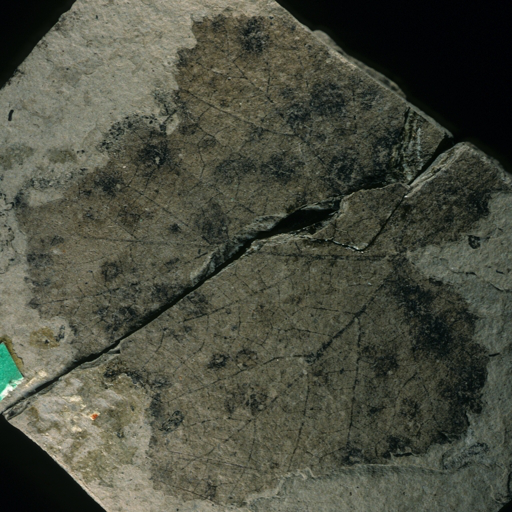

In [34]:
import ipyplot
# ipyplot.plot_class_representations(path_list, label_list, force_b64=True)

ipyplot.plot_class_representations(path_list, name_list, force_b64=True)

In [43]:
ipyplot.plot_class_tabs?



In [15]:
catalog_registry.available_datasets.get("Fossil_family_10_512")

['/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/General_Fossil/512/10/jpg',
 '/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Fossil/Florissant_Fossil/512/10/jpg']

In [10]:
# catalog_registry.available_datasets.search("512")
# catalog_registry.available_datasets.search?
# catalog_registry.available_datasets.get?
catalog_registry.available_datasets.display_all()

In [ ]:
CUDA_VISIBLE_DEVICES=0,1,3,7

In [1]:
from IPython.display import display
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from pathlib import Path
from imutils.utils.dataset_management_utils import Extract


Importing imutils
ASSETS_DIR: /media/data/jacob/GitHub/image-utils/assets
SAMPLE_IMAGE_PATHS: [PosixPath('/media/data/jacob/GitHub/image-utils/assets/Ericaceae_Zenobia_pulverulenta_7984 {WolfeUSGS} [1.96x].jpg'), PosixPath('/media/data/jacob/GitHub/image-utils/assets/Ericaceae_Arbutus_densiflora_1440 {WolfeUSGS} [1.96x].jpg')]


In [3]:
import numpy as np

def plot_class_counts(df,
                      y_col="Family",
                      ax=None,
                      figsize=(25,10),
                      alpha: int=0.8,
                      hue: str=None,
                      ticklabel_rotation: int=40,
                      title: str=None,
                      line_color="black",
                      cmap="copper",
                      xticks=None,
                      xtick_labels=None,
                      log_yaxis: bool=False,
                      lineplot_kwargs=None,
                      **barplot_kwargs):
    
    st = datetime.now()
    print("Start:", str(st))
    
    if ax is None:
        fig, ax = plt.subplots(1,1, figsize=figsize)
    else:
        fig = plt.gcf()
    # plt.rc('xtick', labelsize=3)
    if "normalized_cumsum" in df.columns:
        
        norm = plt.Normalize(df["count"].values.min(), df["count"].values.max())
        colors = plt.cm.get_cmap(cmap)(norm(df["count"]))
        barplot_kwargs.update({"color":colors})
        
        x = list(range(df.shape[0]))
        height = df["count"]
        if xtick_labels is None:
            xtick_labels = df[y_col].values

        # sns.barplot(x="Family", y="count", data=df, hue=hue, alpha=alpha, ax=ax, ci=None, **barplot_kwargs)
        # ax.bar(x=x, height=height, tick_label=tick_label, alpha=alpha, **barplot_kwargs)
        ax.bar(x=x, height=height, alpha=alpha, **barplot_kwargs)
        ax.set_ylabel("Class Count")
        ax.set_xlabel(f"{y_col}") 
        if log_yaxis:
            ax.set_yscale('log')
        
        bar_time = datetime.now()
        et = bar_time - st
        print("End (barplot):", 
              "Barplot only: ", str(et) + "\n",
              "Total: ", str(et) + "\n")
        
        ax2 = ax.twinx()
        lineplot_kwargs = lineplot_kwargs or {"markersize":3.0}
        if "marker" not in lineplot_kwargs:
            lineplot_kwargs.update({"marker":"o"})
        lineplot_kwargs.update(marker="o")
        # sns.lineplot(x="Family", y="normalized_cumsum", data=data_df, alpha=0.6, color=line_color, marker="o", ax=ax2, ci=None)
        ax2.plot(df["normalized_cumsum"]*100.0, alpha=0.6, color=line_color, **lineplot_kwargs) #, ax=ax2)
        ax2.set_ylabel("Normalized Cumulative Sum", color=line_color)
        plt.sca(ax2)
        plt.gca().yaxis.set_major_formatter(plt.FuncFormatter('{:.0f}%'.format))
        
        et2 = datetime.now() - bar_time
        total = datetime.now() - st
        print("End (lineplot):", 
              f"Lineplot only: ", str(et2) + "\n",
              f"Total: ", str(total) + "\n")
        
    else:
        sns.barplot(x=df.index, y=df.values, hue=hue, alpha=alpha, ax=ax, **barplot_kwargs)

    if isinstance(title, str):
        ax.set_title(title)
    
    
    fontsize="xx-small"
    if xticks is None:
        xticks = np.arange(0, max(x))
        fontsize="x-small"
    if len(xticks) > 75:
        resample = int(round(len(x)//75))
        # Only display every other tick label if here are too many
        # sns.set(font_scale=0.5)
        ax.set_xlabel(f"{y_col} (See appendix for complete list)")
        xticks = np.arange(0, max(x), resample)
        xtick_labels = xtick_labels[xticks]
        fontsize="xx-small"
    
    ax.set_xticks(xticks)
    ax.set_xticklabels(xtick_labels, 
                       rotation = ticklabel_rotation,
                       ha="right", 
                       fontsize=fontsize)

    ax.grid(axis="x", color="black", alpha=.5, linewidth=.5)
    ax.grid(axis="y", color="black", alpha=.5, linewidth=.5)
    
    if ax.get_legend():
        ax.get_legend().remove()
    
    return fig, ax


def parse_filenames(data: pd.DataFrame):
    """
    Extract attributes stored as "_"-delimited sections of each sample's filename in `data` DataFrame.
    
    
    Arguments:
        data:
            Must have at least 1 column with name "path" containing absolute file paths.
            
    Return:
        data: pd.DataFrame
            Contains all original columns, as well as with new columns for each attribute, names specifed in `filename_fields` list.
    
    """
    # Named sections of structured filenames, for extracting known sample attributes
    filename_fields = ["Family","Genus","species","collection","catalog_number"]
    data = data.assign(filename = data.path.apply(lambda x: Path(x).stem),
                       path = data.path.apply(str)).convert_dtypes()
    data[filename_fields] = (
        data
        .filename.str.split("_", n=4, expand=True)
        .rename(columns={0:"Family",
                         1:"Genus",
                         2:"species",
                         3:"collection",
                         4:"catalog_number"})
    )
    data = data.assign(Species = data.apply(lambda x: " ".join([x.Genus, x.species]), axis=1))
    return data

## Load and parse datasets

In [6]:
extant_list = Extract.locate_files(EXTANT_ROOT)
general_list = Extract.locate_files(GENERAL_ROOT)
florissant_list = Extract.locate_files(FLORISSANT_ROOT)
print(
    f"extant_list: {len(extant_list['all'])}",
    f"general_list: {len(general_list['all'])}",
    f"florissant_list: {len(florissant_list['all'])}"
)

extant_df = pd.DataFrame({"path":extant_list['all']})
general_df = pd.DataFrame({"path":general_list['all']})
florissant_df = pd.DataFrame({"path":florissant_list['all']})

extant_df = parse_filenames(data=extant_df)
general_df = parse_filenames(data=general_df)
florissant_df = parse_filenames(data=florissant_df)

extant_list: 26176 general_list: 756 florissant_list: 3320


In [27]:
import torch
import torchvision
from PIL import Image


class SupervisedImageDataset(torch.utils.data.Dataset):
    def __init__(self, 
                 df: pd.DataFrame,
                 path_col: str="path",
                 label_col: str="Family"):
        self.df = df
        self.path_col = path_col
        self.label_col = label_col
        self._create_labels()

    def __len__(self):
        return len(self.df)

    def __getitem__(self, index):
        row = self.df.iloc[index]
        return (
            # torchvision.transforms.functional.to_tensor(Image.open(row[self.path_col])),
            Image.open(row[self.path_col]).convert('RGB'),
            row["int_labels"],
        )
    
    def _create_labels(self):
        
        self.classnames = list(set(self.df[self.label_col]))
        print(f"Found {len(self.classnames)} unique labels")

        self.label2int = {l:i for i,l in enumerate(self.classnames)}
        self.int2label = {i:l for l,i in self.label2int.items()}
        
        self.df["int_labels"] = self.df[self.label_col].apply(lambda x: self.label2int[x])

In [ ]:
# df = general_df
# label_col = "Family"

# labels = list(set(df[label_col]))
# print(f"{len(labels)} unique labels")

# label2int = {l:i for i,l in enumerate(labels)}
# int2label = {i:l for l,i in label2int.items()}

In [14]:
%%time

import ffcv
from ffcv.writer import DatasetWriter
from ffcv.fields import RGBImageField, IntField

max_resolution = 512
jpeg_quality = 100

# Your dataset (`torch.utils.data.Dataset`) of (image, label) pairs
ds = SupervisedImageDataset(general_df)
write_path = f'{DATA_CACHE_DIR}/General_Fossil_data.beton'

# Pass a type for each data field
writer = DatasetWriter(write_path, {
    # Tune options to optimize dataset size, throughput at train-time
    'image': RGBImageField(max_resolution=max_resolution, jpeg_quality=jpeg_quality),
    'label': IntField()
})

# Write dataset
writer.from_indexed_dataset(ds)

Found 39 unique labels


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 756/756 [00:43<00:00, 17.22it/s]

CPU times: user 92 ms, sys: 228 ms, total: 320 ms
Wall time: 44.2 s


In [34]:
%%time

from ffcv.loader import Loader, OrderOption
from ffcv.transforms import ToTensor, ToDevice, ToTorchImage, Cutout
from ffcv.fields.decoders import IntDecoder, RandomResizedCropRGBImageDecoder

from tqdm import tqdm, trange

# Random resized crop
decoder = RandomResizedCropRGBImageDecoder((512,512))

# Data decoding and augmentation
image_pipeline = [decoder, Cutout(20), ToTensor(), ToTorchImage(), ToDevice(0)]
label_pipeline = [IntDecoder(), ToTensor(), ToDevice(0)]

pipelines = {
    'image': image_pipeline,
    'label': label_pipeline
}

write_path = f'{DATA_CACHE_DIR}/General_Fossil_data-{max_resolution}.beton'

loader = Loader(write_path, batch_size=32, num_workers=4,
                order=OrderOption.RANDOM, pipelines=pipelines)

# rest of training / validation proceeds identically
load_iter = iter(loader)

for epoch in trange(len(loader)):
    batch = next(load_iter)


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:06<00:00,  3.53it/s]

CPU times: user 7.22 s, sys: 216 ms, total: 7.44 s
Wall time: 7.06 s


In [19]:
grid_img = torchvision.utils.make_grid(batch[0], nrow=5)

plt.figure(figsize=(12,12))
plt.imshow(grid_img.permute(1,2,0).cpu().numpy())

In [25]:
%%time

import ffcv
from ffcv.writer import DatasetWriter
from ffcv.fields import RGBImageField, IntField

max_resolution = 512
jpeg_quality = 100

# Your dataset (`torch.utils.data.Dataset`) of (image, label) pairs
ds = SupervisedImageDataset(florissant_df)
write_path = f'{DATA_CACHE_DIR}/Florissant_Fossil_data-{max_resolution}.beton'

# Pass a type for each data field
writer = DatasetWriter(write_path, {
    # Tune options to optimize dataset size, throughput at train-time
    'image': RGBImageField(max_resolution=max_resolution, jpeg_quality=jpeg_quality),
    'label': IntField()
})

# Write dataset
writer.from_indexed_dataset(ds)

Found 23 unique labels


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3320/3320 [03:55<00:00, 14.11it/s]

CPU times: user 324 ms, sys: 1.58 s, total: 1.91 s
Wall time: 3min 56s


In [33]:
%%time

from ffcv.loader import Loader, OrderOption
from ffcv.transforms import ToTensor, ToDevice, ToTorchImage, Cutout
from ffcv.fields.decoders import IntDecoder, RandomResizedCropRGBImageDecoder

from tqdm import tqdm, trange

# Random resized crop
decoder = RandomResizedCropRGBImageDecoder((512,512))

# Data decoding and augmentation
image_pipeline = [decoder, Cutout(20), ToTensor(), ToTorchImage(), ToDevice(0)]
label_pipeline = [IntDecoder(), ToTensor(), ToDevice(0)]

pipelines = {
    'image': image_pipeline,
    'label': label_pipeline
}

write_path = f'{DATA_CACHE_DIR}/Florissant_Fossil_data-{max_resolution}.beton'

loader = Loader(write_path, batch_size=32, num_workers=4,
                order=OrderOption.RANDOM, pipelines=pipelines)

# rest of training / validation proceeds identically
load_iter = iter(loader)

for epoch in trange(len(loader)):
    batch = next(load_iter)


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 103/103 [00:08<00:00, 12.08it/s]

CPU times: user 10.6 s, sys: 1.12 s, total: 11.7 s
Wall time: 9.12 s


In [28]:
%%time

import ffcv
from ffcv.writer import DatasetWriter
from ffcv.fields import RGBImageField, IntField

max_resolution = 512
jpeg_quality = 100

# Your dataset (`torch.utils.data.Dataset`) of (image, label) pairs
ds = SupervisedImageDataset(extant_df)
write_path = f'{DATA_CACHE_DIR}/Extant_Leaves_data-{max_resolution}.beton'

# Pass a type for each data field
writer = DatasetWriter(write_path, {
    # Tune options to optimize dataset size, throughput at train-time
    'image': RGBImageField(max_resolution=max_resolution, jpeg_quality=jpeg_quality),
    'label': IntField()
})

# Write dataset
writer.from_indexed_dataset(ds)

Found 354 unique labels



 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 20800/26176 [09:24<01:19, 67.55it/s]DecompressionBombWarning: Image size (97228460 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 21300/26176 [09:48<02:27, 32.99it/s]DecompressionBombWarning: Image size (106021165 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 23800/26176 [10:50<00:29, 81.90it/s]DecompressionBombWarning: Image size (99645408 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.

 92%|████████████████████████████████████

CPU times: user 1.84 s, sys: 2.17 s, total: 4.01 s
Wall time: 12min 9s


In [38]:
from ffcv.loader import Loader, OrderOption
from ffcv.transforms import ToTensor, ToDevice, ToTorchImage, Cutout
from ffcv.fields.decoders import IntDecoder, RandomResizedCropRGBImageDecoder

from tqdm import tqdm, trange

# Random resized crop
decoder = RandomResizedCropRGBImageDecoder((512,512))

# Data decoding and augmentation
image_pipeline = [decoder, Cutout(1), ToTensor(), ToTorchImage(), ToDevice(0)]
label_pipeline = [IntDecoder(), ToTensor(), ToDevice(0)]

pipelines = {
    'image': image_pipeline,
    'label': label_pipeline
}

write_path = f'{DATA_CACHE_DIR}/Extant_Leaves_data-{max_resolution}.beton'

# Replaces PyTorch data loader (`torch.utils.data.Dataloader`)
loader = Loader(write_path, batch_size=32, num_workers=4,
                order=OrderOption.RANDOM, pipelines=pipelines)

# rest of training / validation proceeds identically
load_iter = iter(loader)

for epoch in trange(len(loader)):
    batch = next(load_iter)
    break


  0%|                                                                                                                                                                | 0/818 [00:05<?, ?it/s]


In [43]:
import numba
numba.__version__

'0.55.1'

<Figure size 864x864 with 0 Axes>

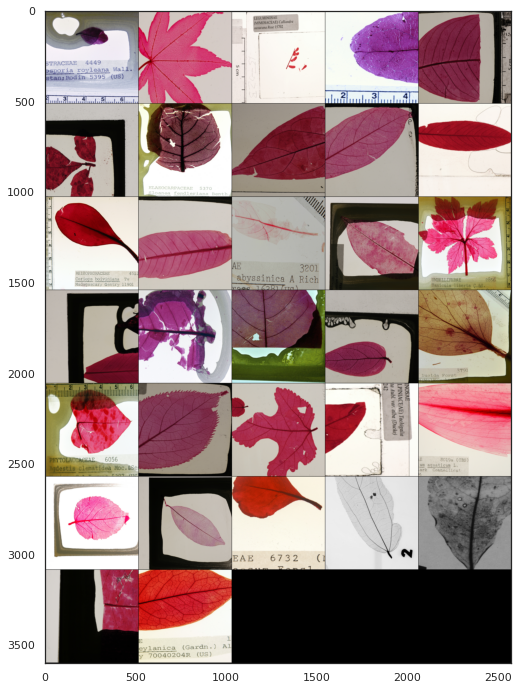

In [39]:
grid_img = torchvision.utils.make_grid(batch[0], nrow=5)

plt.figure(figsize=(12,12))
plt.imshow(grid_img.permute(1,2,0).cpu().numpy())

In [14]:
import cv2

help(cv2.imencode)

Help on built-in function imencode:

imencode(...)
    imencode(ext, img[, params]) -> retval, buf
    .   @brief Encodes an image into a memory buffer.
    .   
    .   The function imencode compresses the image and stores it in the memory buffer that is resized to fit the
    .   result. See cv::imwrite for the list of supported formats and flags description.
    .   
    .   @param ext File extension that defines the output format.
    .   @param img Image to be written.
    .   @param buf Output buffer resized to fit the compressed image.
    .   @param params Format-specific parameters. See cv::imwrite and cv::ImwriteFlags.



### Test a single plot

In [39]:
import os
from pprint import pprint as pp

PNAS_leaf_classes = [
     'Anacardiaceae',
     'Annonaceae',
     'Apocynaceae',
     'Betulaceae',
     'Celastraceae',
     'Combretaceae',
     'Ericaceae',
     'Fabaceae',
     'Fagaceae',
     'Lauraceae',
     'Malvaceae',
     'Melastomataceae',
     'Myrtaceae',
     'Passifloraceae',
     'Phyllanthaceae',
     'Rosaceae',
     'Rubiaceae',
     'Salicaceae',
     'Sapindaceae'
                      ]
# sorted(PNAS_leaf_classes)

classnames_path = Path(OUTPUTS_DIR, "PNAS_19-Family_classnames.csv")
if not os.path.isfile(classnames_path):
    
    df = pd.DataFrame(
        PNAS_leaf_classes, 
        index=range(len(PNAS_leaf_classes))
                     )
    
    df.to_csv(classnames_path, index=False)
    print(f"Wrote {len(df)} Family names from PNAS Leaves to {classnames_path}")
    pp(PNAS_leaf_classes)
# classnames_path

Wrote 19 Family names from PNAS Leaves to /media/data/jacob/GitHub/image-utils/notebooks/plots/PNAS_19-Family_classnames.csv
['Anacardiaceae',
 'Annonaceae',
 'Apocynaceae',
 'Betulaceae',
 'Celastraceae',
 'Combretaceae',
 'Ericaceae',
 'Fabaceae',
 'Fagaceae',
 'Lauraceae',
 'Malvaceae',
 'Melastomataceae',
 'Myrtaceae',
 'Passifloraceae',
 'Phyllanthaceae',
 'Rosaceae',
 'Rubiaceae',
 'Salicaceae',
 'Sapindaceae']


In [15]:
style = "dark" # 'seaborn-notebook'
cmap = "Spectral" #"gist_stern_r"
context = "notebook"
# plt.style.use(style)
sns.set(rc={"figure.dpi":200, 'savefig.dpi':300})

sns.set_context(context)
sns.set_style(style)
sns.set_palette(sns.color_palette("mako"))

In [16]:
catalog_path = "/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_0-patch_2/catalogs/full_catalog-v1.0-patch.2--12_20_21.csv"

df = pd.read_csv(catalog_path, index_col=0)

In [ ]:
sns.countplot(data=df, x="Family", color="blue", alpha=0.8, linewidth=0, order=df.value_counts("Family").index) # multiple='stack', log_scale=(False,True),cumulative=True)
# hue="data_subset",


plt.gca().set_xticks([])
# ax.set_xticklabels(tick_label[xticks], 
#                    rotation = ticklabel_rotation,
#                    ha="right", 
#                    fontsize=fontsize)



plt.figure(figsize=(25,10))


data = df.groupby("Family").nunique()

# fig, ax = plt.subplots(1,1, figsize=(20,10))
sns.histplot(data=df, hue="collection", x="Genus", multiple="stack", discrete=True, legend=None)#, log_scale=True)#, alpha=0.9, height=12, ratio=4, kind='scatter') #, legend=False, 
# sns.jointplot(data=data, x="Genus", y="Species", alpha=0.9, height=12, ratio=4, kind='scatter') #, legend=False, log_scale=True) #, kind='hist')#, figsize=(20,10))

# ax = plt.gca()
# ax.set_yscale("log")
# ax.set_xscale("log")





<Figure size 1800x720 with 0 Axes>

<Figure size 1800x720 with 0 Axes>

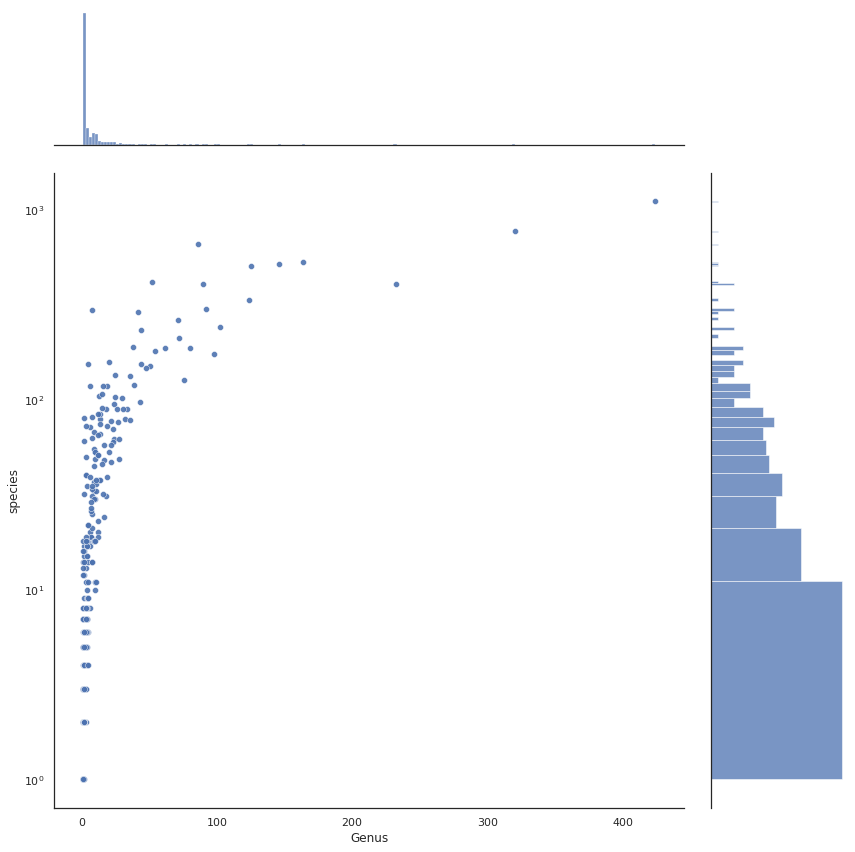

In [31]:
plt.figure(figsize=(25,10))


data = df.groupby("Family").nunique()

# fig, ax = plt.subplots(1,1, figsize=(20,10))
sns.jointplot(data=data, x="Genus", y="species", alpha=0.9, height=12, ratio=4, kind='scatter') #, legend=False, log_scale=True) #, kind='hist')#, figsize=(20,10))

ax = plt.gca()
ax.set_yscale("log")
ax.set_xscale("log")

In [20]:
dsets = [extant_df,
    general_df,
    florissant_df]

taxon_cols = ['Family', 'Genus', 'species', 'collection', 'catalog_number', 'Species']

for col in taxon_cols:
    for df in dsets:
        gb = df.groupby(col)
        
        gb.ngroups
        df.describe(include='all')
        break
    break
gb

354

,path,filename,Family,Genus,species,collection,catalog_number,Species
count,26176,26176,26176,26176,26176,26176,26176,26176
unique,26176,26176,354,4573,7807,4,26176,17389
top,/media/data_cifs/projects/prj_fossils/data/processed_data/leavesdb-v1_1/images/Extant_Leaves/original/full/jpg/Trochodendraceae/Trochodendraceae_Tetracentron_sinense_Wolfe_Wolfe_514.jpg,Trochodendraceae_Tetracentron_sinense_Wolfe_Wolfe_514,Fabaceae,Quercus,sp,Wolfe,Wolfe_514,Hymenaea courbaril
freq,1,1,2301,395,124,16249,1,42


In [34]:
styles = ['seaborn-dark',
    'seaborn-darkgrid',
    'seaborn-ticks',
    'fivethirtyeight',
    'seaborn-whitegrid',
    'classic',
    '_classic_test',
    'seaborn-talk',
    'seaborn-dark-palette',
    'seaborn-bright',
    'seaborn-pastel',
    'grayscale',
    'seaborn-notebook',
    'ggplot',
    'seaborn-colorblind',
    'seaborn-muted',
    'seaborn',
    'seaborn-paper',
    'bmh',
    'seaborn-white',
    'dark_background',
    'seaborn-poster',
    'seaborn-deep'
         ]

style = 'seaborn-notebook'
cmap = "Spectral" #"gist_stern_r"
plt.style.use(style)


# plt.figure(figsize=(25,10))
# def plot_groupby_hist(df: pd.DataFrame,
#                       )

# gb[["Genus", "species"]].nunique().hist(ax=plt.gca(), bins=100, alpha=0.8)

In [ ]:
def categorical_order(values, order=None):
    """Return a list of unique data values.

    Determine an ordered list of levels in ``values``.

    Parameters
    ----------
    values : list, array, Categorical, or Series
        Vector of "categorical" values
    order : list-like, optional
        Desired order of category levels to override the order determined
        from the ``values`` object.

    Returns
    -------
    order : list
        Ordered list of category levels

    """
    if order is None:
        if hasattr(values, "categories"):
            order = values.categories
        else:
            try:
                order = values.cat.categories
            except (TypeError, AttributeError):
                try:
                    order = values.unique()
                except AttributeError:
                    order = pd.unique(values)

    return list(order)


In [8]:
# # sns.set(rc={"figure.dpi":100, 'savefig.dpi':300})
# sns.set(rc={"figure.dpi":300, 'savefig.dpi':300})

# context = "paper"
# sns.set_context(context)
# style = "dark" # "darkgrid"
# sns.set_style(style)
# sns.set_palette(
#     sns.color_palette("mako")
# )

# y_col = "Family"
# barplot_kwargs = {
#     "edgecolor":"black",
#     "linewidth":1.0,
#     "width":0.9
#     # "width":0.8,
#     # "dodge":False,
#     # "saturation":0.5
# }

# """Accent, Accent_r, Blues, Blues_r, BrBG, BrBG_r, BuGn, BuGn_r, BuPu, BuPu_r, CMRmap, CMRmap_r, Dark2, Dark2_r, GnBu, GnBu_r, Greens, Greens_r, Greys, Greys_r, OrRd, OrRd_r, Oranges, Oranges_r, PRGn, PRGn_r, Paired, Paired_r, Pastel1, Pastel1_r, Pastel2, Pastel2_r, PiYG, PiYG_r, PuBu, PuBuGn, PuBuGn_r, PuBu_r, PuOr, PuOr_r, PuRd, PuRd_r, Purples, Purples_r, RdBu, RdBu_r, RdGy, RdGy_r, RdPu, RdPu_r, RdYlBu, RdYlBu_r, RdYlGn, RdYlGn_r, Reds, Reds_r, Set1, Set1_r, Set2, Set2_r, Set3, Set3_r, Spectral, Spectral_r, Vega10, Vega10_r, Vega20, Vega20_r, Vega20b, Vega20b_r, Vega20c, Vega20c_r, Wistia, Wistia_r, YlGn, YlGnBu, YlGnBu_r, YlGn_r, YlOrBr, YlOrBr_r, YlOrRd, YlOrRd_r, afmhot, afmhot_r, autumn, autumn_r, binary, binary_r, bone, bone_r, brg, brg_r, bwr, bwr_r, cool, cool_r, coolwarm, coolwarm_r, copper, copper_r, cubehelix, cubehelix_r, flag, flag_r, gist_earth, gist_earth_r, gist_gray, gist_gray_r, gist_heat, gist_heat_r, gist_ncar, gist_ncar_r, gist_rainbow, gist_rainbow_r, gist_stern, gist_stern_r, gist_yarg, gist_yarg_r, gnuplot, gnuplot2, gnuplot2_r, gnuplot_r, gray, gray_r, hot, hot_r, hsv, hsv_r, icefire, icefire_r, inferno, inferno_r, jet, jet_r, magma, magma_r, mako, mako_r, nipy_spectral, nipy_spectral_r, ocean, ocean_r, pink, pink_r, plasma, plasma_r, prism, prism_r, rainbow, rainbow_r, rocket, rocket_r, seismic, seismic_r, spectral, spectral_r, spring, spring_r, summer, summer_r, tab10, tab10_r, tab20, tab20_r, tab20b, tab20b_r, tab20c, tab20c_r, terrain, terrain_r, viridis, viridis_r, vlag, vlag_r, winter, winter_r
# """

# styles = ['seaborn-dark',
#     'seaborn-darkgrid',
#     'seaborn-ticks',
#     'fivethirtyeight',
#     'seaborn-whitegrid',
#     'classic',
#     '_classic_test',
#     'seaborn-talk',
#     'seaborn-dark-palette',
#     'seaborn-bright',
#     'seaborn-pastel',
#     'grayscale',
#     'seaborn-notebook',
#     'ggplot',
#     'seaborn-colorblind',
#     'seaborn-muted',
#     'seaborn',
#     'seaborn-paper',
#     'bmh',
#     'seaborn-white',
#     'dark_background',
#     'seaborn-poster',
#     'seaborn-deep'
#          ]

# df = florissant_df
# df = general_df
# df = extant_df
# name="florissant"
# name="general"
# name="extant"

# style = styles[8]
# cmap = "Spectral" #"gist_stern_r"
# print(f"Using style: {style}, cmap: {cmap}")
# plt.style.use(style)

# num_samples = df.shape[0]
# data_df = (
#     pd.DataFrame(
#         {"count":df.value_counts(y_col),
#          "normalized_cumsum":df.value_counts(y_col).cumsum()/num_samples})
#     .reset_index(drop=False)
# )

# fig, ax = plot_class_counts(data_df,
#                             y_col=y_col,
#                             ax=None,
#                             figsize=(20,10),
#                             hue="normalized_cumsum",
#                             alpha=0.6,
#                             ticklabel_rotation=40,
#                             cmap=cmap,
#                             title=name + f" {y_col} Distribution",
#                             **barplot_kwargs)

# %time plt.savefig(f"{name}-test_image.png")
# %time plt.savefig(f"{name}-test_image.svg")

## Create plots

In [10]:
# %load_ext snakeviz
# from IPython.display import set_matplotlib_formats
# set_matplotlib_formats('retina')

# sns.set(rc={"figure.dpi":100, 'savefig.dpi':300})

# context = "paper"
# sns.set_context(context)
# style = "darkgrid"
# sns.set_style(style)
# sns.set_palette(
#     sns.color_palette("mako")
# )

# y_col = "Family"
# barplot_kwargs = {
#     # "width":0.8,
#     # "dodge":False,
#     # "saturation":0.5
# }

# plt.style.use('fivethirtyeight')

# df = data_df
# norm = plt.Normalize(df["count"].values.min(), df["count"].values.max())
# colors = plt.cm.copper_r(norm(df["count"])) 
# # barplot_kwargs.update({"palette":colors})
# colors

In [22]:
%load_ext snakeviz
sns.set(rc={"figure.dpi":200, 'savefig.dpi':300})

context = "paper"
sns.set_context(context)
style = "dark" # "darkgrid"
sns.set_style(style)
sns.set_palette(
    sns.color_palette("mako")
)

# y_col = "Family"
barplot_kwargs = {
    "edgecolor":"black",
    "linewidth":0.5,
    "width":0.9
    # "width":0.8,
    # "dodge":False,
    # "saturation":0.5
}

styles = ['seaborn-dark',
    'seaborn-darkgrid',
    'seaborn-ticks',
    'fivethirtyeight',
    'seaborn-whitegrid',
    'classic',
    '_classic_test',
    'seaborn-talk',
    'seaborn-dark-palette',
    'seaborn-bright',
    'seaborn-pastel',
    'grayscale',
    'seaborn-notebook',
    'ggplot',
    'seaborn-colorblind',
    'seaborn-muted',
    'seaborn',
    'seaborn-paper',
    'bmh',
    'seaborn-white',
    'dark_background',
    'seaborn-poster',
    'seaborn-deep'
         ]

style = styles[8]
cmap = "Spectral" #"gist_stern_r"
print(f"Using style: {style}, cmap: {cmap}")
plt.style.use(style)

Using style: seaborn-dark-palette, cmap: Spectral


Start: 2022-02-07 10:42:48.297245
End (barplot): Barplot only:  0:00:00.403809
 Total:  0:00:00.403809

End (lineplot): Lineplot only:  0:00:00.023015
 Total:  0:00:00.426829

Saved: /media/data/jacob/GitHub/image-utils/notebooks/plots/Extant Leaves-Family_Counts-x-CumSum.svg
Start: 2022-02-07 10:42:49.977584
End (barplot): Barplot only:  0:00:00.065121
 Total:  0:00:00.065121

End (lineplot): Lineplot only:  0:00:00.022920
 Total:  0:00:00.088045

Saved: /media/data/jacob/GitHub/image-utils/notebooks/plots/General Fossils-Family_Counts-x-CumSum.svg
Start: 2022-02-07 10:42:50.689738
End (barplot): Barplot only:  0:00:00.050049
 Total:  0:00:00.050049

End (lineplot): Lineplot only:  0:00:00.024707
 Total:  0:00:00.074760

Saved: /media/data/jacob/GitHub/image-utils/notebooks/plots/Florissant Fossils-Family_Counts-x-CumSum.svg


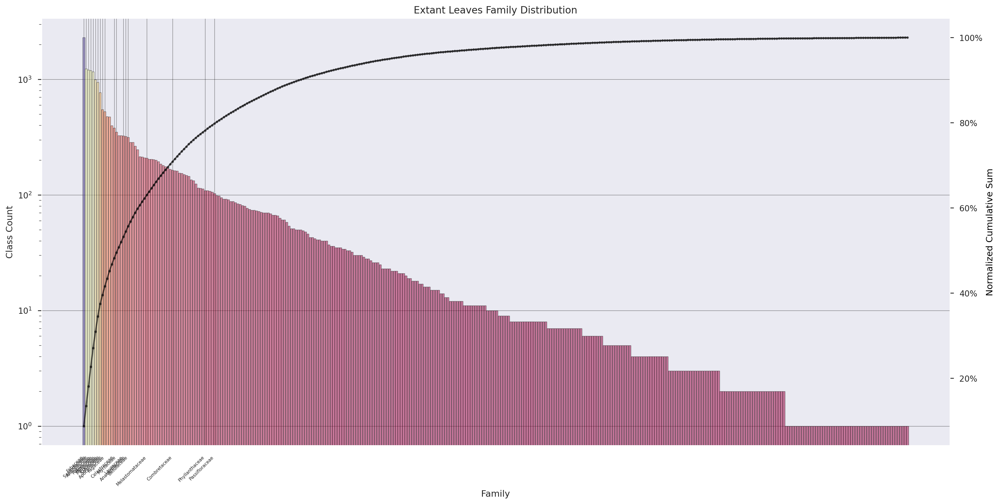

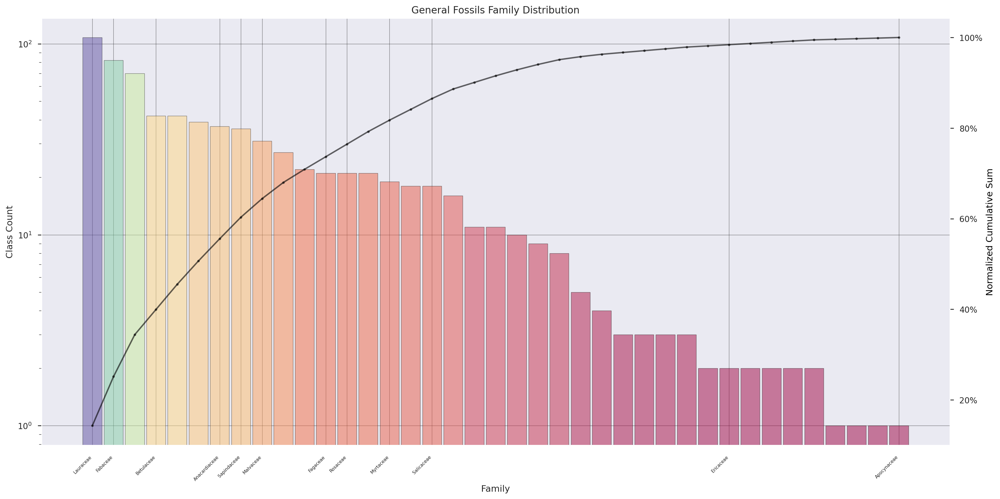

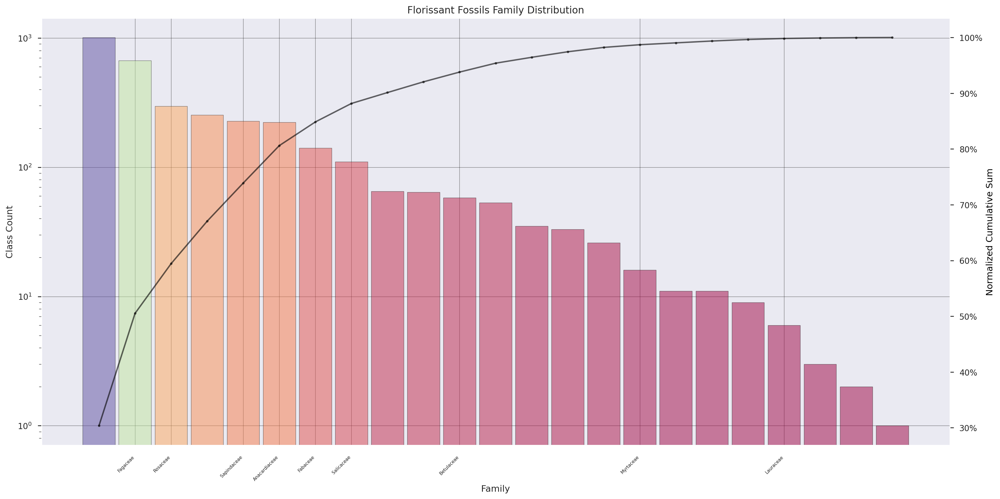

In [55]:
# %%snakeviz
lineplot_kwargs = {"markersize":3.0}

for y_col in ["Family"]: # , "Genus", "Species"]:
    for name, df in zip(
        ["Extant Leaves", "General Fossils", "Florissant Fossils"], # [::-1],
        [extant_df, general_df, florissant_df] # [::-1]
    ):
        
        # y_col="Species"
        # name="Extant Leaves"
        # df=extant_df
        
        num_samples = df.shape[0]
        data_df = (
            pd.DataFrame(
                {"count":df.value_counts(y_col),
                 "normalized_cumsum":df.value_counts(y_col).cumsum()/num_samples})
            .reset_index(drop=False)
        )
        
        xticks_df = data_df[data_df.Family.isin(PNAS_leaf_classes)]
        xticks, xtick_labels = list(xticks_df.index), list(xticks_df.Family)

        fig, ax = plot_class_counts(data_df,
                                    y_col=y_col,
                                    ax=None,
                                    figsize=(20,10),
                                    hue="normalized_cumsum",
                                    alpha=0.5,
                                    ticklabel_rotation=45,
                                    cmap=cmap,
                                    title=name + f" {y_col} Distribution",
                                    xticks=xticks,
                                    xtick_labels=xtick_labels,
                                    log_yaxis=True,
                                    lineplot_kwargs=lineplot_kwargs,
                                    **barplot_kwargs)
        
        
        fig.subplots_adjust(bottom=0.15)
        filepath = Path(OUTPUTS_DIR, name + f"-{y_col}_Counts-x-CumSum" + ".svg")
        plt.savefig(filepath) #, bbox_inches="tight")
        print(f"Saved: {filepath}")
        data_table_path = Path(OUTPUTS_DIR, name + f"-{y_col}_Counts-x-CumSum_table" + ".csv")
        data_df.to_csv(data_table_path)
        # break
    # break